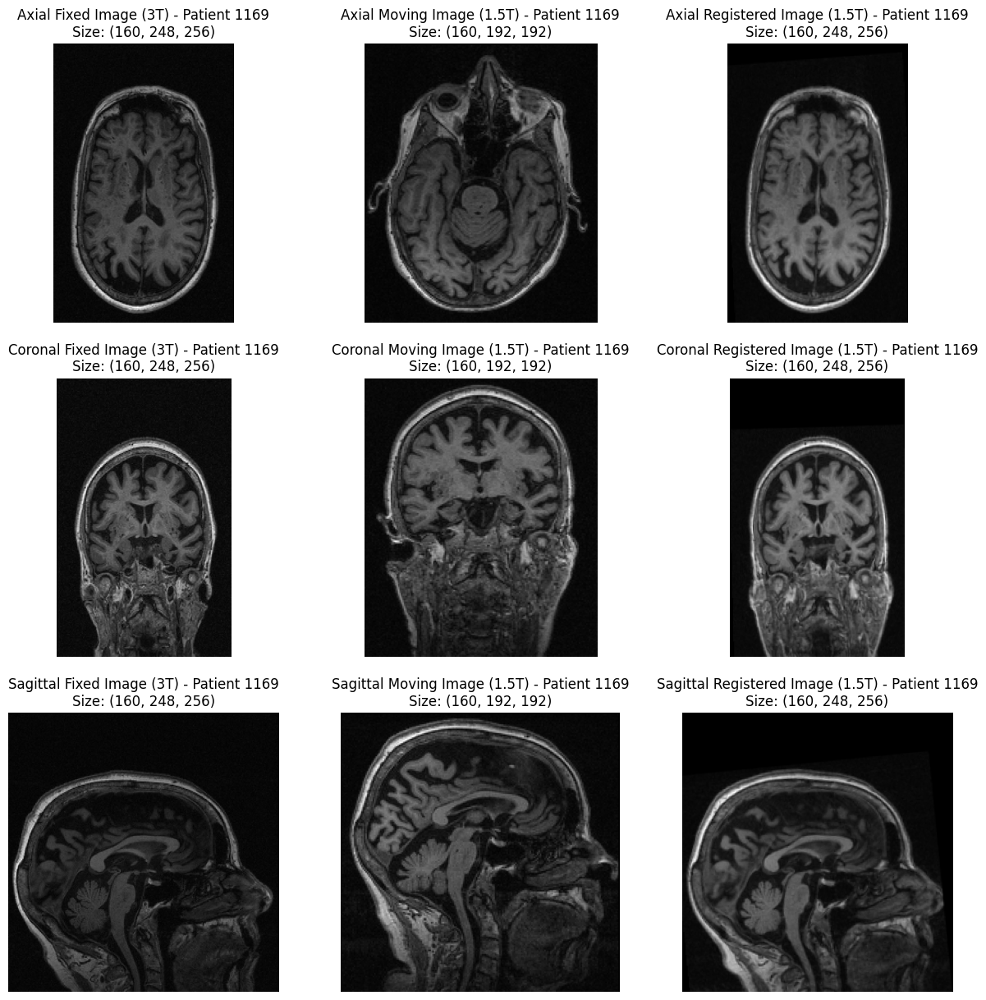

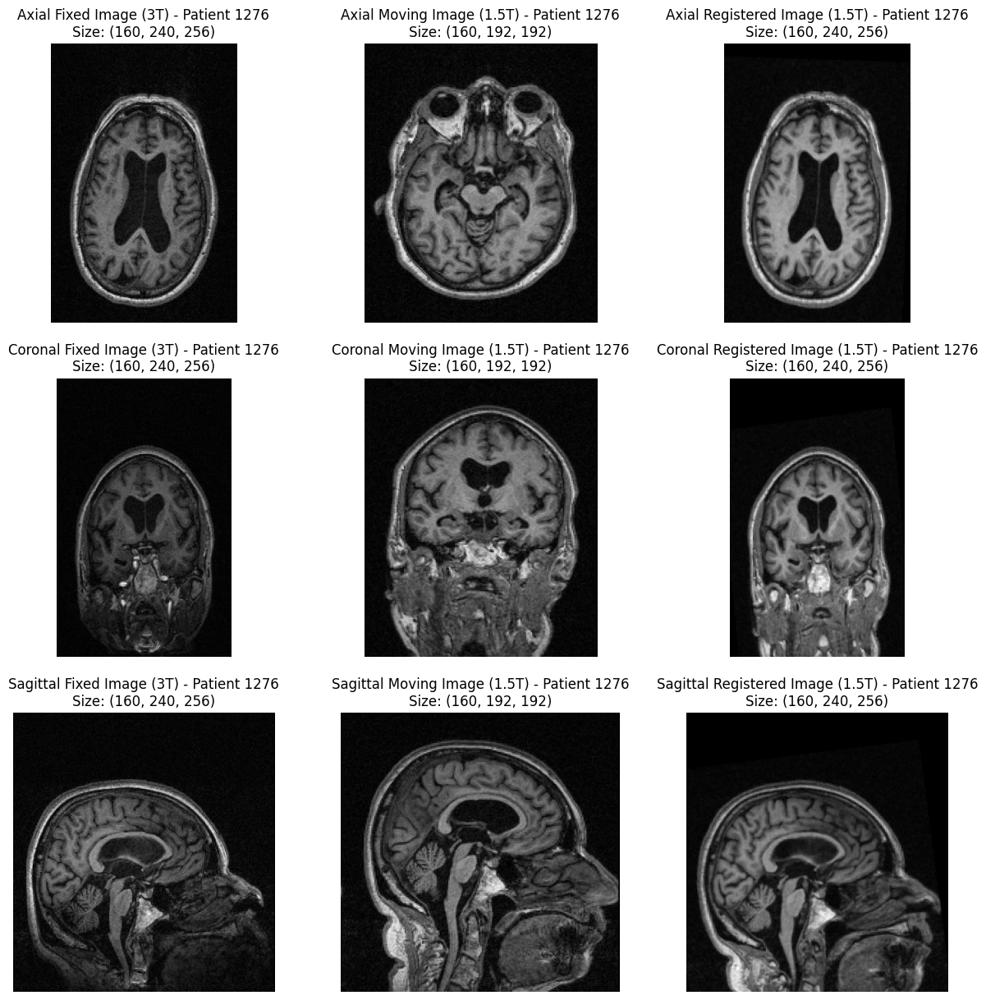

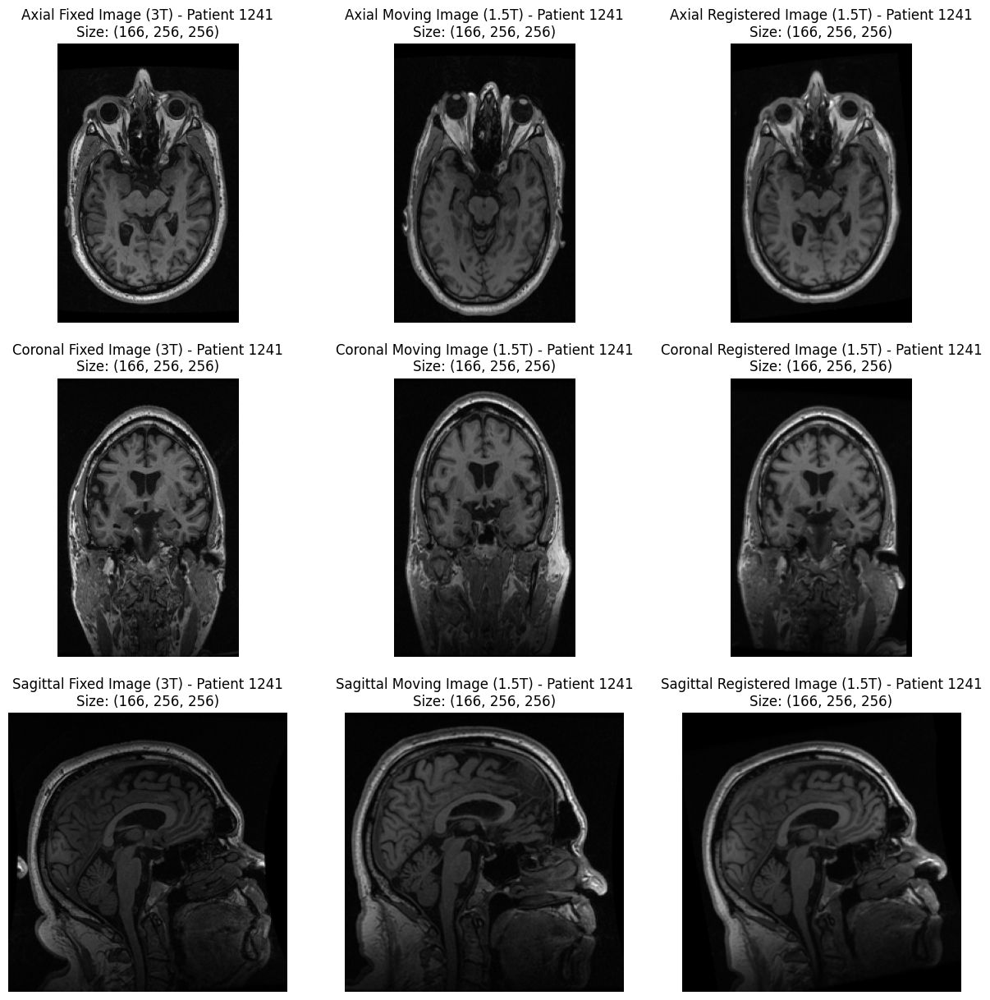

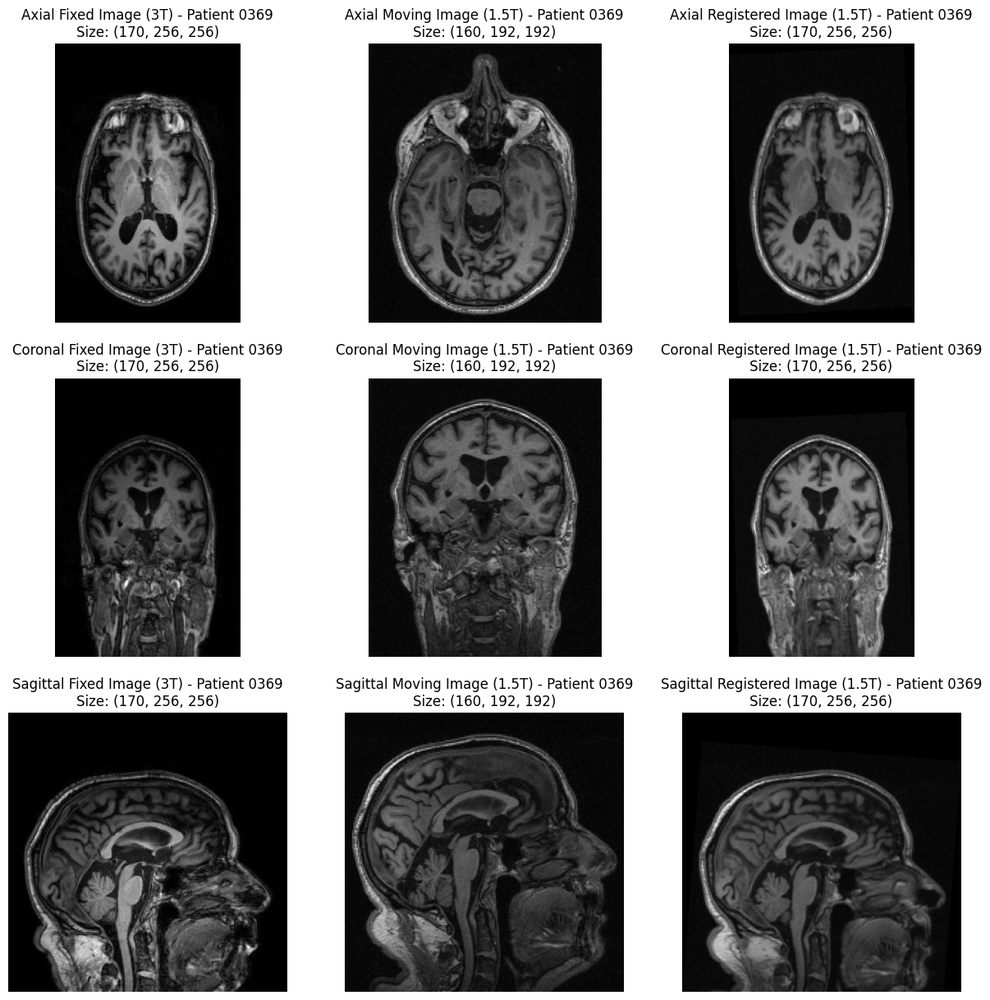

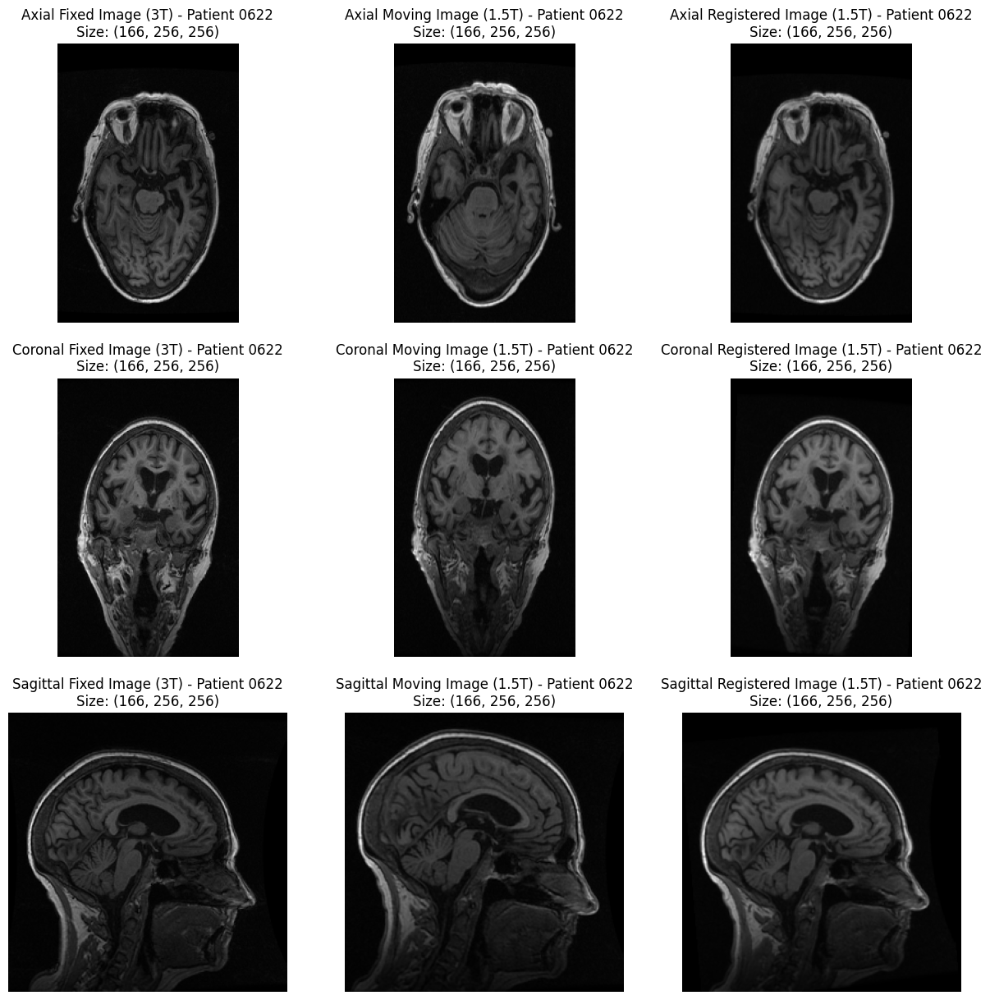

...

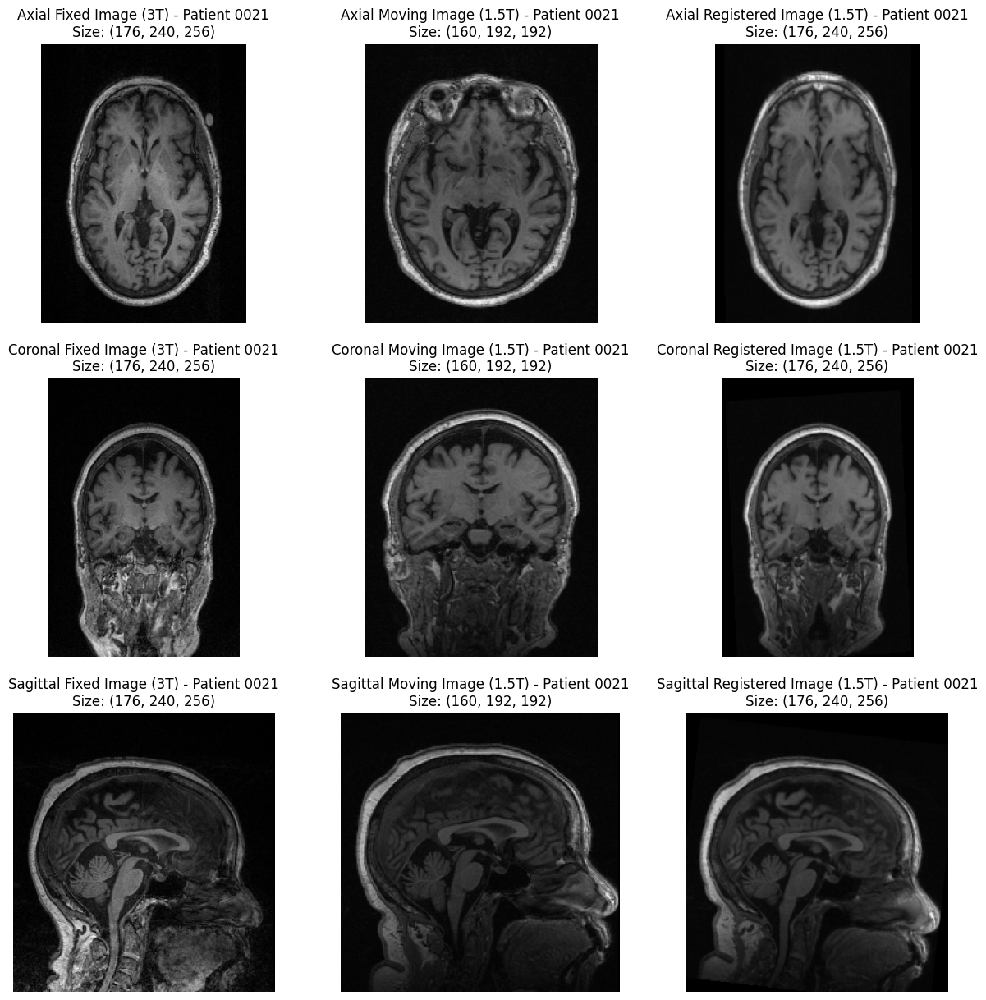

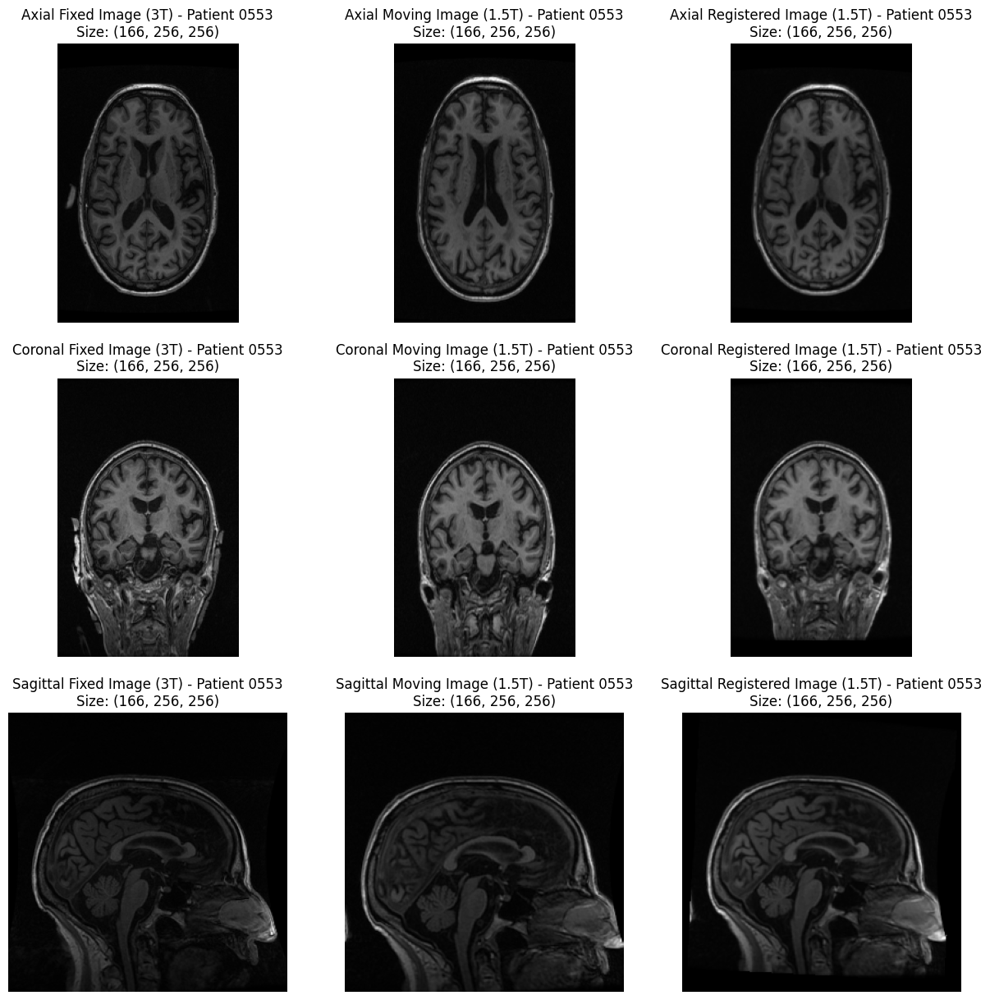

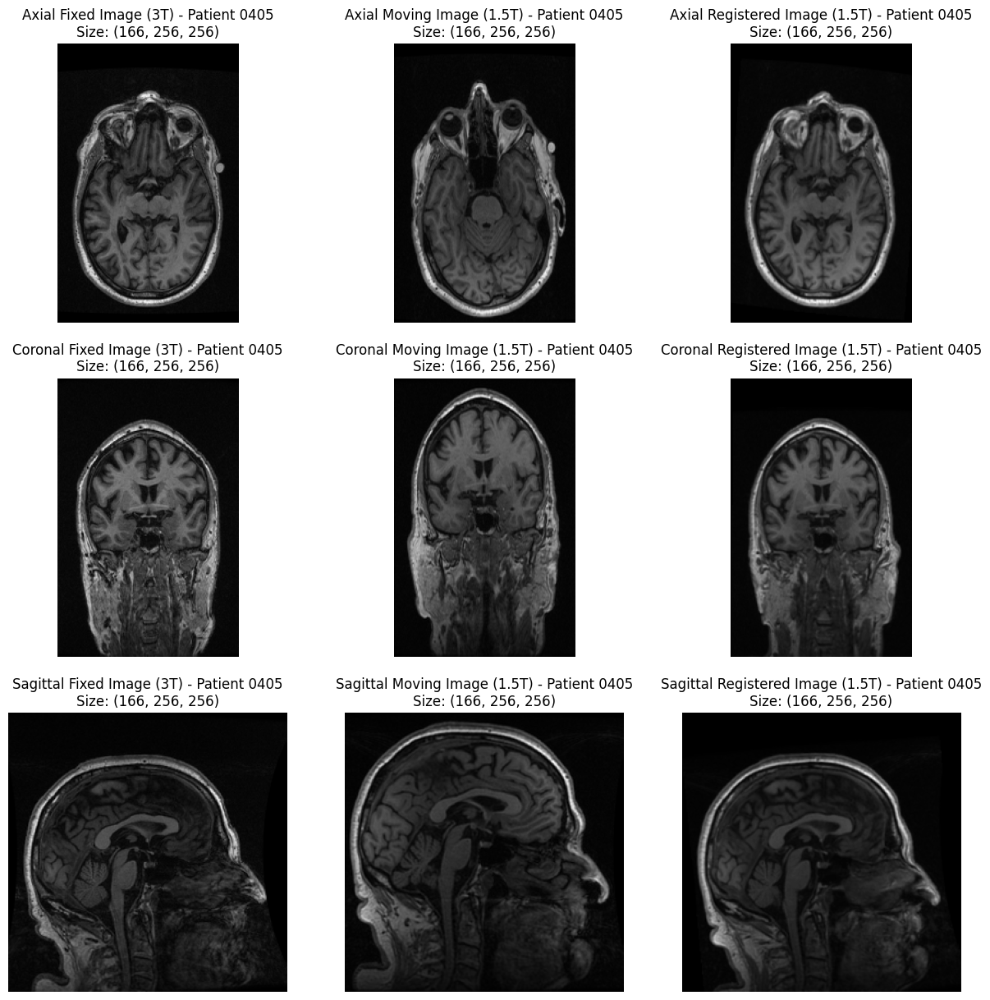

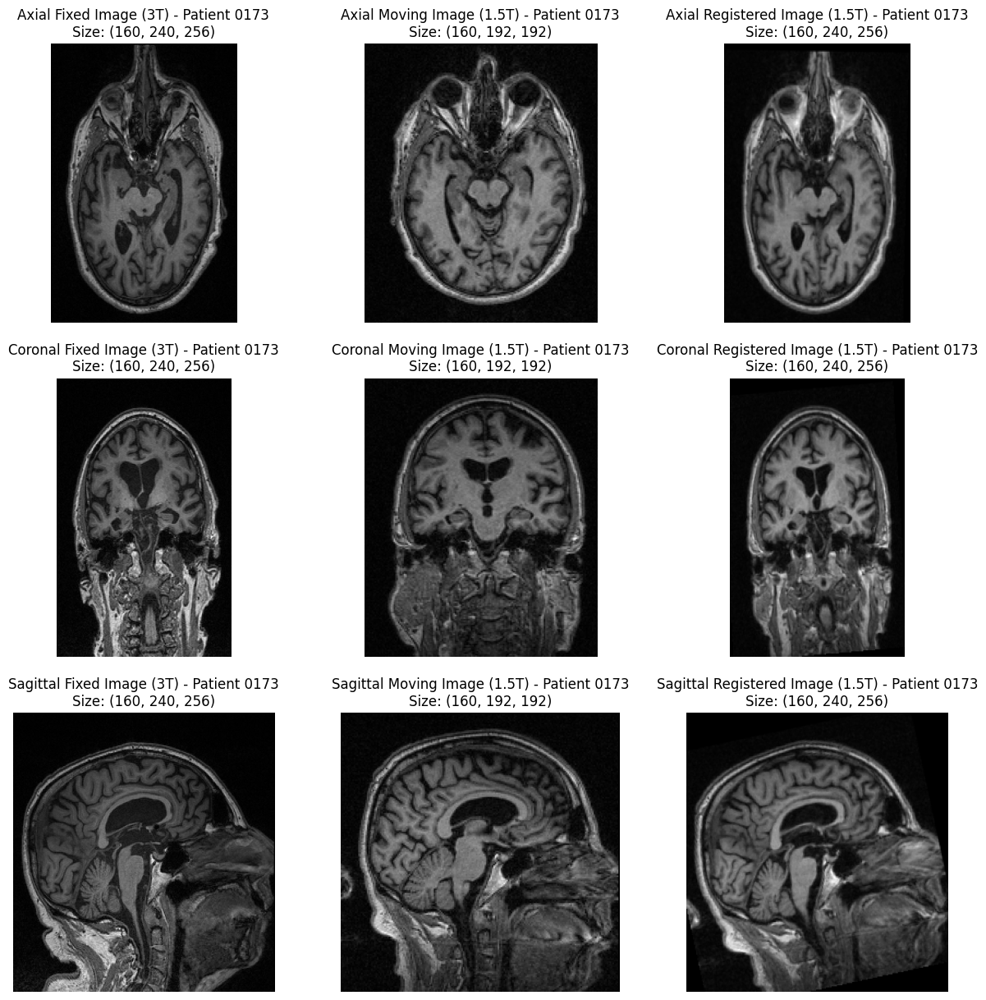

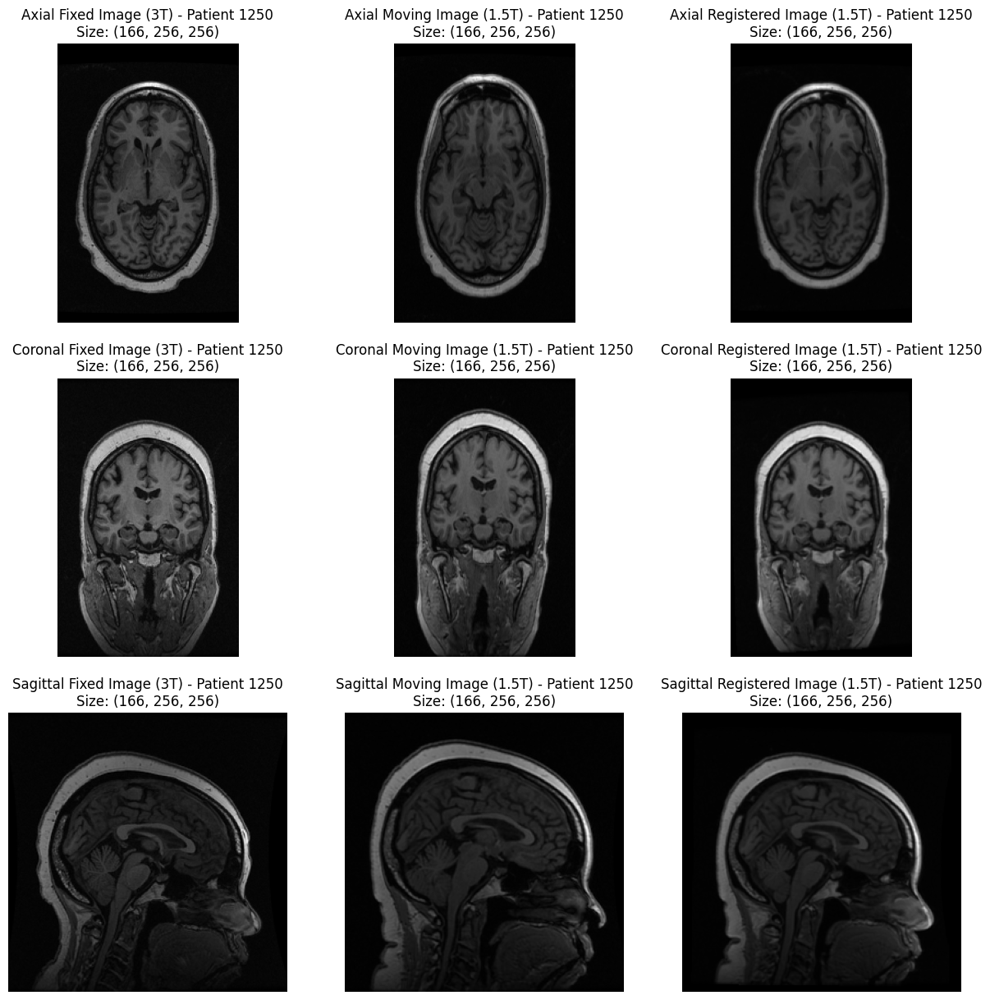

In [1]:
import os
import SimpleITK as sitk
import glob
import numpy as np
import matplotlib.pyplot as plt

def load_image(file_path):
    return sitk.ReadImage(file_path, sitk.sitkFloat32)

def visualize_registration(fixed_image, moving_image, registered_image, patient_id):
    fig, axes = plt.subplots(3, 3, figsize=(15, 15))
    
    fixed_slice = sitk.GetArrayViewFromImage(fixed_image)
    moving_slice = sitk.GetArrayViewFromImage(moving_image)
    registered_slice = sitk.GetArrayViewFromImage(registered_image)
    

    fixed_size = fixed_image.GetSize()
    moving_size = moving_image.GetSize()
    registered_size = registered_image.GetSize()
    
    axes[0, 0].imshow(np.flipud(fixed_slice[fixed_slice.shape[0] // 2]), cmap='gray')
    axes[0, 0].set_title(f'Axial Fixed Image (3T) - Patient {patient_id}\nSize: {fixed_size}')
    axes[0, 0].axis('off')

    axes[1, 0].imshow(np.flipud(fixed_slice[:, fixed_slice.shape[1] // 2, :]), cmap='gray')
    axes[1, 0].set_title(f'Coronal Fixed Image (3T) - Patient {patient_id}\nSize: {fixed_size}')
    axes[1, 0].axis('off')

    axes[2, 0].imshow(np.flipud(fixed_slice[:, :, fixed_slice.shape[2] // 2]), cmap='gray')
    axes[2, 0].set_title(f'Sagittal Fixed Image (3T) - Patient {patient_id}\nSize: {fixed_size}')
    axes[2, 0].axis('off')
    
    axes[0, 1].imshow(np.flipud(moving_slice[moving_slice.shape[0] // 2]), cmap='gray')
    axes[0, 1].set_title(f'Axial Moving Image (1.5T) - Patient {patient_id}\nSize: {moving_size}')
    axes[0, 1].axis('off')

    axes[1, 1].imshow(np.flipud(moving_slice[:, moving_slice.shape[1] // 2, :]), cmap='gray')
    axes[1, 1].set_title(f'Coronal Moving Image (1.5T) - Patient {patient_id}\nSize: {moving_size}')
    axes[1, 1].axis('off')

    axes[2, 1].imshow(np.flipud(moving_slice[:, :, moving_slice.shape[2] // 2]), cmap='gray')
    axes[2, 1].set_title(f'Sagittal Moving Image (1.5T) - Patient {patient_id}\nSize: {moving_size}')
    axes[2, 1].axis('off')
    
    axes[0, 2].imshow(np.flipud(registered_slice[registered_slice.shape[0] // 2]), cmap='gray')
    axes[0, 2].set_title(f'Axial Registered Image (1.5T) - Patient {patient_id}\nSize: {registered_size}')
    axes[0, 2].axis('off')

    axes[1, 2].imshow(np.flipud(registered_slice[:, registered_slice.shape[1] // 2, :]), cmap='gray')
    axes[1, 2].set_title(f'Coronal Registered Image (1.5T) - Patient {patient_id}\nSize: {registered_size}')
    axes[1, 2].axis('off')

    axes[2, 2].imshow(np.flipud(registered_slice[:, :, registered_slice.shape[2] // 2]), cmap='gray')
    axes[2, 2].set_title(f'Sagittal Registered Image (1.5T) - Patient {patient_id}\nSize: {registered_size}')
    axes[2, 2].axis('off')
    
    plt.show()

def visualize_patient_folder(output_dir, original_dataset_dir):
    patient_folders = [f.path for f in os.scandir(output_dir) if f.is_dir()]
    for patient_folder in patient_folders:
        patient_id = os.path.basename(patient_folder)
        registered_image_path = glob.glob(os.path.join(patient_folder, '*_registered.nii.gz'))
        original_image_3T_path = glob.glob(os.path.join(patient_folder, '*3.0T*.nii.gz'))
        
        if registered_image_path and original_image_3T_path:
            registered_image = load_image(registered_image_path[0])
            original_image_3T = load_image(original_image_3T_path[0])
            
            original_image_1_5T_path = registered_image_path[0].replace('_registered.nii.gz', '.nii.gz')
            if not os.path.exists(original_image_1_5T_path):
                original_image_1_5T_path = glob.glob(os.path.join(original_dataset_dir, patient_id, '*1.5T*.nii.gz'))
                if original_image_1_5T_path:
                    original_image_1_5T_path = original_image_1_5T_path[0]
                else:
                    print(f"Original 1.5T image not found for {registered_image_path[0]}")
                    continue
            
            original_image_1_5T = load_image(original_image_1_5T_path)
            visualize_registration(original_image_3T, original_image_1_5T, registered_image, patient_id)

original_dataset_dir = '/scratch/Costanza/ADNI_DDPM_S_Single_Pairs'
visualize_patient_folder('/scratch/Costanza/Registration/ADNI_DDPM_S_R1_10', original_dataset_dir)
